variables: folder, topology file, trajectory file, output file
public imports: os, MDAnalysis
private imports: visualize
Create a universe object from a topology file and a trajectory file and visualize the trajectory using the function: visualize_mda_universe; description: <insert-description-here>
visualize the trajectory


Pending documentation:
what does the function do under the hood

In [1]:
"""
variables:
1) folder: The directory containing the input topology and the trajectory files.
2) topology_file
3) trajectory_file

4) all-residue samples' output_dir 
5) 2-residue samples' output_dir, (to focus on in-conformation and out-conformation)

do I need all five here? yes 
"""

"""
when I run visualize_mda_universe, it creates 190 odd samples;
the samples are used by pymol under the wraps, for visualization
"""
from visualize import visualize_mda_universe # local file


import os

"""
folder = "/home/uni/capstone/test-bioemu-ubq/"
topology_file = os.path.join(folder, "topology.pdb")
trajectory_file = os.path.join(folder, "samples.xtc")
"""

"""
folder = "/home/uni/capstone/2k39_7686d/hpacker-openmm/"
topology_file = os.path.join(folder, "hpacker-openmm-md-equil.pdb")
trajectory_file = os.path.join(folder, "hpacker-openmm-md-equil.xtc")
"""

"""
folder = "/home/uni/capstone/2k39_7686d/hpacker-openmm/"
os.path.join(folder, "hpacker-openmm_sidechain_rec.pdb")
topology_file = os.path.join(folder, "hpacker-openmm_sidechain_rec.pdb")
trajectory_file = os.path.join(folder, "hpacker-openmm_sidechain_rec.xtc")
"""

"""
folder = "/home/uni/bioemu-project/samples/"
topology_file = os.path.join(folder, "topology.pdb")
trajectory_file = os.path.join(folder, "samples.xtc")
"""

"""
folder = "/home/uni/necessary-things-for-recreating-bioemu-project-from-scratch/"
topology_file = os.path.join(folder, ".2k39-backbone-bioemu-samples/topology.pdb")
trajectory_file = os.path.join(folder, ".2k39-backbone-bioemu-samples/samples.xtc")
"""

"""
folder = "/home/uni/necessary-things-for-recreating-bioemu-project-from-scratch/"
topology_file = os.path.join(folder, "2k39-backbone-bioemu-samples/topology.pdb")
trajectory_file = os.path.join(folder, "visualization-fixed/combined-samples-trajectory.pdb")
"""

folder = "/home/uni/necessary-things-for-recreating-bioemu-project-from-scratch/"
topology_file = os.path.join(folder, "PDBs/topology-1200-odd-atoms.pdb")
trajectory_file = os.path.join(folder, "PDBs/visualization-1200-odd-atoms/combined-samples-trajectory.pdb")
import MDAnalysis as mda 
u = mda.Universe(topology_file, trajectory_file)
view = visualize_mda_universe(u,
                              output_dir="/home/uni/necessary-things-for-recreating-bioemu-project-from-scratch/PDBs/visualization-1200-odd-atoms-and-ran-through-pipeline",)

view.show()

/home/uni/miniconda3/lib/python3.13/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [2]:
import rmsd_for_atom_groups as rmsd

rmsd.rmsd_for_atomgroups(u, selection1="backbone", selection2=["protein"])


194


,backbone,protein
frame,,
0,0.00,0.00
1,1.79,3.01
2,1.49,2.50
3,1.43,2.79
4,1.87,2.95
...,...,...
189,2.31,2.95
190,2.73,3.42
191,1.98,3.15


194


Text(0, 0.5, 'RMSD (Angstrom)')

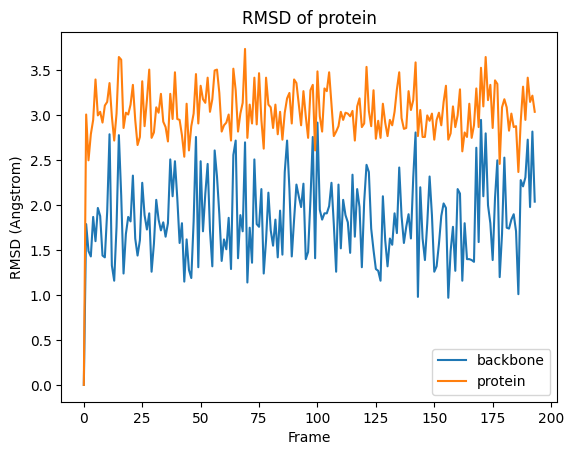

In [3]:
import numpy as np
import pandas as pd
from MDAnalysis.analysis import rms

selection1 = "backbone"
selection2 = ["protein"]

print(len(u.trajectory))
u.trajectory[0]
ref = u
rmsd_analysis = rms.RMSD(u, ref, select=selection1, groupselections=selection2)
rmsd_analysis.run()
columns = [selection1, *selection2] if selection2 else [selection1]
rmsd_df = pd.DataFrame(np.round(rmsd_analysis.rmsd[:, 2:], 2), columns=columns)
rmsd_df.index.name = "Frame"
rmsd_df.head()


import matplotlib.pyplot as plt
rmsd_df.plot(title="RMSD of protein")
plt.ylabel("RMSD (Angstrom)")


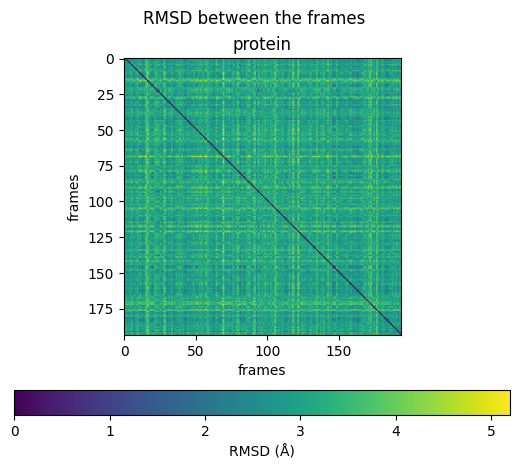

In [4]:
from MDAnalysis.analysis import diffusionmap

pairwise_rmsd = diffusionmap.DistanceMatrix(u, select="protein")
pairwise_rmsd.run()
dist_matrix_protein = pairwise_rmsd.dist_matrix
max_dist = np.amax(dist_matrix_protein)



fig, ax = plt.subplots(1,1)
fig.suptitle("RMSD between the frames")

# protein image
img1 = ax.imshow(dist_matrix_protein, cmap="viridis", vmin=0, vmax=max_dist)
ax.title.set_text("protein")
ax.set_xlabel("frames")
ax.set_ylabel("frames")


fig.colorbar(img1, ax=ax, orientation="horizontal", fraction=0.1, label="RMSD (Å)")

to go:
1) distance maps
2) see if the conformations sampled represent the peptide flip phenomenon in ubiquitin

for distance maps there is a function

In [5]:
protein_residue_id1 = "54"
protein_residue_id2 = "25"
""" 
view = visualize_mda_universe(u, 
                            output_dir='bioemu-samples-local-ubq-2-residues', 
                            sel_string=f"resid {protein_residue_id1} or (resid {protein_residue_id2})",
                            style= {'stick': {}}
                            )
"""
"""
view = visualize_mda_universe(u, 
                              output_dir='visualization-of-2-residues-in-and-out-conformations', 
                              sel_string=f"resid {protein_residue_id1} or (resid {protein_residue_id2})",
                              style= {'stick': {}}
                              )

"""
view = visualize_mda_universe(u, 
                              output_dir='/home/uni/necessary-things-for-recreating-bioemu-project-from-scratch/PDBs/visualization-1200-odd-atoms-and-ran-through-pipeline-but-2-residues-version', 
                              sel_string=f"resid {protein_residue_id1} or (resid {protein_residue_id2})",
                              style= {'stick': {}}
                              )
view.show()



3Dmol.js failed to load for some reason. Please check your browser console for error messages.

1 1
The distance between residues 54 and 25 is 9.70 Å


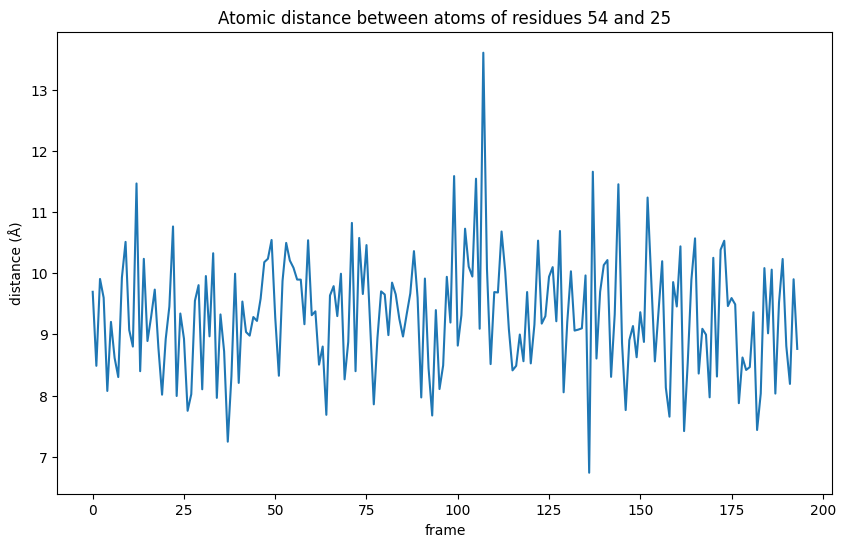

In [6]:

# --

protein_atom_name1 = "N"
protein_atom_name2 = "OD1" # was OE1, changed to OD1 to match count of atoms

# --

atomgroup_protein1 = u.select_atoms(
    f"resid {protein_residue_id1} and name {protein_atom_name1}")
atomgroup_protein2 = u.select_atoms(
    f"resid {protein_residue_id2} and name {protein_atom_name2}")

# --

from MDAnalysis.analysis.distances import dist

print(atomgroup_protein1.n_atoms, atomgroup_protein2.n_atoms)
distance = dist(atomgroup_protein1, atomgroup_protein2)
print(
    f"The distance between residues {protein_residue_id1} and {protein_residue_id2} is {distance[2][0]:.2f} Å"
)


# --

distances = []
for _ in u.trajectory:
    distance = dist(atomgroup_protein1, atomgroup_protein2)
    distances.append(distance[2][0])

# --

plt.figure(figsize=(10, 6))
plt.plot(distances)
#plt.gca().set_ylim(bottom=0)
plt.ylabel("distance (Å)")
plt.xlabel("frame")
plt.title(f"Atomic distance between atoms of residues {protein_residue_id1} and {protein_residue_id2}")
plt.show()

In [7]:
# writing out a frame to a file
# here the frame with the minimum distance is selected
print("Minimum distance:", min(distances))
print("Frame with minimum distance (counting from 0):", distances.index(min(distances)))
print(distances.index(min(distances)))
frame_index = distances.index(min(distances))
u.trajectory[frame_index]  
selected_atoms = u.select_atoms("all")  
with mda.Writer("bioemu-local-frame-30.pdb", selected_atoms.n_atoms) as writer:
    writer.write(selected_atoms)
print("Frame written to bioemu-local-frame-30.pdb")

Minimum distance: 6.739718244619238
Frame with minimum distance (counting from 0): 136
136
Frame written to bioemu-local-frame-30.pdb
